In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import itertools # Importando itertools para generar combinaciones de columnas
# Importando la función seasonal_decompose para la descomposición de series temporales
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.patches as mpatches
import payments_manager as pm
#pm.help()
#pm.reset()
pm.init() #debug=True)
cr_cp = pm.df('cr_cp')
fe_cp = pm.df('fe_cp')
#cr_cp.info()
#fe_cp.info()

df_jo = pm.df('df_jo')
#df_jo.info()
df_jo = pm.sort("df_jo", ["id_cr"]).reset_index()
df_jo = df_jo.drop(columns=['index'])
#df_jo = df_jo.drop(columns=['Mes_created_at'])
df_jo_cp = df_jo.copy()
df_jo_cp['cr_received_date'] = df_jo_cp.cash_request_received_date


In [2]:
df = pm.df('df_jall')
#df = df_jo_cp

#display(df)
#display(df[~df.Mes_created_at.isna()])

# Tiempo que tarda en recibir el dinero el usuario desde la primera accion.
# cr_received_date  (cash_request_received_date) = ??
df['to_receive_ini'] = df.cr_received_date-df.created_at

# Tiempo que tarda en recibir el dinero el usuario desde que se envia.
df['to_receive_bank'] = df.cr_received_date-df.send_at

# Tiempo que la empresa recupera el dinero desde la primera accion.
df['to_reimbur'] = df.reimbursement_date-df.created_at

# Tiempo que la empresa presta el dinero.
df['to_end'] = df.reimbursement_date-df.money_back_date

#* Demora:
df['to_delay'] = df.money_back_date-df.reimbursement_date

# TransfType: instant send_at - created_at =? 0 dias
# TransfType: regular send_at - created_at =? 7 dias
df['to_send'] = df.send_at-df.created_at

df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32094 entries, 0 to 32093
Data columns (total 38 columns):
 #   Column                      Non-Null Count  Dtype          
---  ------                      --------------  -----          
 0   id_cr                       32094 non-null  int64          
 1   amount                      32094 non-null  float64        
 2   stat_cr                     32094 non-null  object         
 3   created_at                  32094 non-null  datetime64[ns] 
 4   updated_at_x                32094 non-null  datetime64[ns] 
 5   user_id                     32094 non-null  int64          
 6   active                      32094 non-null  int64          
 7   moderated_at                21759 non-null  datetime64[ns] 
 8   reimbursement_date          32094 non-null  datetime64[ns] 
 9   cash_request_received_date  24149 non-null  datetime64[ns] 
 10  money_back_date             23917 non-null  datetime64[ns] 
 11  transfer_type               32094 non-nul

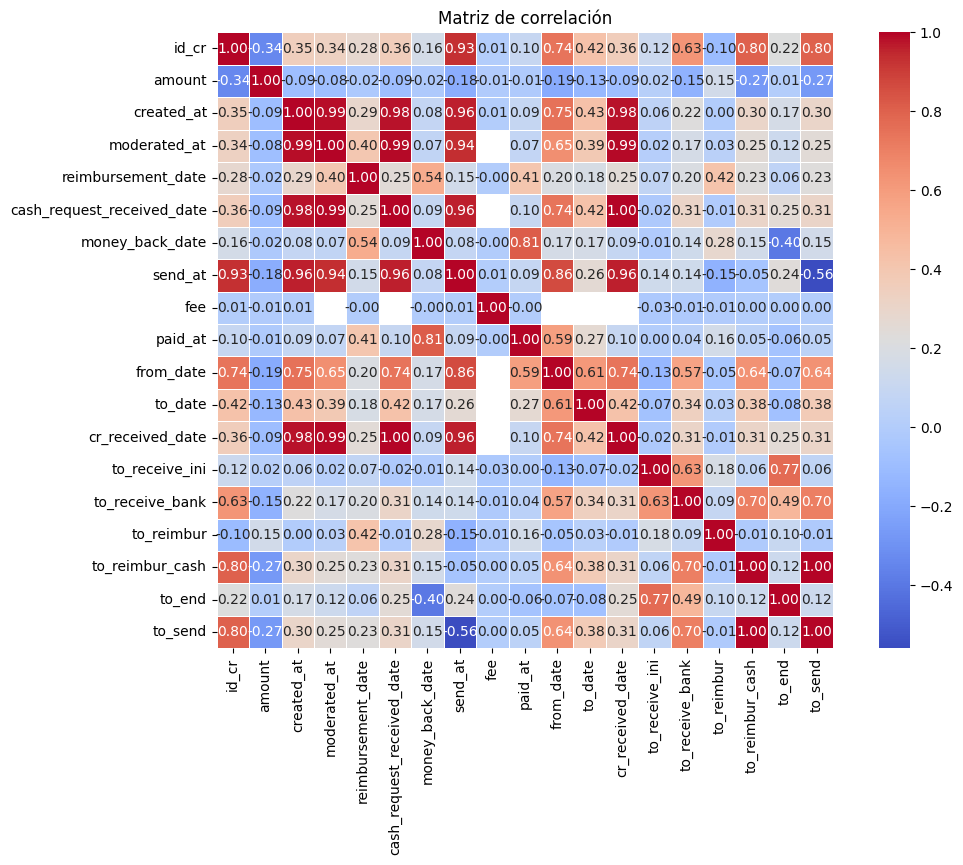

In [7]:
df = pm.df('df_jo')
df = df.drop(columns=['active'])
df = df.drop(columns=['Mes_created_at'])
#df = df.drop(columns=['fee']) #df = df.drop(columns=['total_amount'])
df = df.drop(columns=['user_id'])

d_list = list(df.select_dtypes(include=['datetime64']).columns)
for date in d_list:
    df[date] = pd.to_datetime(df[date]).dt.strftime('%Y%m%d').astype(float)
df_corr = df.select_dtypes(include=['number'])
matriz_corr = df_corr.corr()
plt.figure(figsize=(12, 8)) 
sns.heatmap(matriz_corr, annot=True, cmap='coolwarm', fmt=".2f", square=True, linewidths=0.5)
plt.title('Matriz de correlación')
plt.show()

In [8]:
df = pm.df('df_jo')
cr_id = ['id_cr','user_id', 'created_at','amount','fee','stat_cr','stat_fe','transfer_type','type',
            'to_receive_ini', 'to_receive_bank','to_reimbur','to_reimbur_cash','to_end','to_send',
             'send_at', 'cr_received_date', #'money_back_date', 'reimbursement_date',
            'paid_at','charge_moment','moderated_at'] # ,'id_y','from_date','to_date','reason','recovery_status', 'cash_request_id'

# print("Casos segun Cash Request ID")
# for id in ([ 23534]): # 20108, 20104, 20112,
#     df_t = df[df['id_cr'] == id].reset_index()
#     print(f"Cash Request ID: {id}")
#     display(df_t[cr_id].sort_values('created_at'))

user_ids = [430,  63894,18730,10116,21465, 99000262]

print("Casos segun Cash User ID")
for id in (user_ids):
    df_t = df[df['user_id'] == id].reset_index()
    print(f"User ID: {id}")
    display(df_t[cr_id].sort_values('created_at'))


Casos segun Cash User ID
User ID: 430


,id_cr,user_id,created_at,amount,fee,stat_cr,stat_fe,transfer_type,type,to_receive_ini,to_receive_bank,to_reimbur,to_reimbur_cash,to_end,to_send,send_at,cr_received_date,paid_at,charge_moment,moderated_at
2,9,430,2019-12-10 19:14:41.668754,100.0,NaN,money_back,NaN,regular,NaN,0 days 04:45:18.331246,NaT,29 days 03:45:18.331246,NaT,-125 days +11:54:30,NaT,NaT,2019-12-11,NaT,NaN,2019-12-11 09:50:51.000000
1,467,430,2020-01-17 11:29:05.432003,100.0,NaN,money_back,NaN,regular,NaN,3 days 12:30:54.567997,NaT,109 days 10:30:54.567997,NaT,-1 days +23:56:49,NaT,NaT,2020-01-21,NaT,NaN,2020-01-17 13:13:01.000000
0,1782,430,2020-05-14 11:14:47.514595,100.0,NaN,money_back,NaN,regular,NaN,1 days 12:45:12.485405,NaT,24 days 10:45:12.485405,NaT,-6 days +23:37:49.853066,NaT,NaT,2020-05-16,NaT,NaN,2020-05-14 11:50:41.868243
3,2830,430,2020-06-09 19:45:23.206590,100.0,NaN,money_back,NaN,regular,NaN,2 days 04:14:36.793410,NaT,27 days 02:14:36.793410,NaT,-1 days +00:00:00,NaT,NaT,2020-06-12,NaT,NaN,2020-06-10 12:05:29.376060
4,9490,430,2020-07-23 09:02:34.005290,100.0,NaN,money_back,NaN,regular,NaN,1 days 14:57:25.994710,-6 days +14:57:25.995079,12 days 12:57:25.994710,5 days 12:57:25.995079,0 days 00:00:00,6 days 23:59:59.999631,2020-07-30 09:02:34.004921,2020-07-25,NaT,NaN,2020-07-23 16:55:25.885721
6,11315,430,2020-08-07 10:45:39.925622,100.0,5.0,money_back,accepted,instant,instant_payment,3 days 13:14:20.074378,-4 days +13:14:20.074878,28 days 11:14:20.074378,21 days 11:14:20.074878,-1 days +02:10:28.881092,6 days 23:59:59.999500,2020-08-14 10:45:39.925122,2020-08-11,2020-09-05 19:49:31.158259,after,2020-08-07 12:14:55.758037
5,14889,430,2020-09-07 01:57:47.526378,100.0,5.0,money_back,accepted,instant,instant_payment,0 days 22:02:12.473622,-7 days +22:02:12.525576,29 days 20:02:12.473622,22 days 20:02:12.525576,-1 days +02:12:33.154000,6 days 23:59:59.948046,2020-09-14 01:57:47.474424,2020-09-08,2020-10-07 19:47:26.874666,after,2020-09-07 07:56:36.718827
7,20548,430,2020-10-12 07:20:47.854343,100.0,5.0,money_back,accepted,instant,instant_payment,0 days 16:39:12.145657,0 days 16:39:00.481351,24 days 14:39:12.145657,24 days 14:39:00.481351,-1 days +01:23:32.715173,0 days 00:00:11.664306,2020-10-12 07:20:59.518649,2020-10-13,2020-11-06 20:36:27.323330,after,2020-10-12 08:15:14.616682


User ID: 63894


,id_cr,user_id,created_at,amount,fee,stat_cr,stat_fe,transfer_type,type,to_receive_ini,to_receive_bank,to_reimbur,to_reimbur_cash,to_end,to_send,send_at,cr_received_date,paid_at,charge_moment,moderated_at
0,20108,63894,2020-10-09 11:02:54.071547,100.0,5.0,money_back,accepted,instant,instant_payment,0 days 12:57:05.928453,0 days 12:56:34.511204,27 days 23:57:05.928453,27 days 23:56:34.511204,-1 days +15:32:21.086619,0 days 00:00:31.417249,2020-10-09 11:03:25.488796,2020-10-10,2020-11-06 19:27:38.941414,after,NaT
1,20108,63894,2020-10-09 11:02:54.071547,100.0,5.0,money_back,cancelled,instant,postpone,0 days 12:57:05.928453,0 days 12:56:34.511204,27 days 23:57:05.928453,27 days 23:56:34.511204,-1 days +15:32:21.086619,0 days 00:00:31.417249,2020-10-09 11:03:25.488796,2020-10-10,NaT,after,NaT
2,20108,63894,2020-10-09 11:02:54.071547,100.0,5.0,money_back,cancelled,instant,postpone,0 days 12:57:05.928453,0 days 12:56:34.511204,27 days 23:57:05.928453,27 days 23:56:34.511204,-1 days +15:32:21.086619,0 days 00:00:31.417249,2020-10-09 11:03:25.488796,2020-10-10,NaT,after,NaT


User ID: 18730


,id_cr,user_id,created_at,amount,fee,stat_cr,stat_fe,transfer_type,type,to_receive_ini,to_receive_bank,to_reimbur,to_reimbur_cash,to_end,to_send,send_at,cr_received_date,paid_at,charge_moment,moderated_at
1,4187,18730,2020-06-19 12:04:38.487602,100.0,NaN,money_back,NaN,regular,NaN,3 days 11:55:21.512398,NaT,17 days 09:55:21.512398,NaT,-1 days +00:00:00,NaT,NaT,2020-06-23,NaT,NaN,2020-06-19 13:05:01.750011
2,8416,18730,2020-07-16 07:54:54.357013,100.0,NaN,money_back,NaN,regular,NaN,4 days 16:05:05.642987,NaT,20 days 14:05:05.642987,NaT,0 days 00:00:00,NaT,NaT,2020-07-21,NaT,NaN,2020-07-17 10:55:36.753979
4,12099,18730,2020-08-11 23:05:32.819727,100.0,NaN,money_back,NaN,regular,NaN,8 days 00:54:27.180273,1 days 00:54:27.180950,26 days 22:54:27.180273,19 days 22:54:27.180950,-1 days +02:44:22.134158,6 days 23:59:59.999323,2020-08-18 23:05:32.819050,2020-08-20,NaT,NaN,NaT
3,15336,18730,2020-09-09 12:23:09.953940,100.0,NaN,money_back,NaN,regular,NaN,8 days 11:36:50.046060,1 days 11:36:50.092277,27 days 09:36:50.046060,20 days 09:36:50.092277,-1 days +02:05:27.333983,6 days 23:59:59.953783,2020-09-16 12:23:09.907723,2020-09-18,NaT,NaN,NaT
0,20104,18730,2020-10-09 10:58:48.319330,100.0,5.0,money_back,cancelled,regular,postpone,10 days 13:01:11.680670,3 days 13:01:11.683695,15 days 00:01:08.332670,8 days 00:01:08.335695,-5 days +11:59:56.652000,6 days 23:59:59.996975,2020-10-16 10:58:48.316305,2020-10-20,NaT,before,NaT


User ID: 10116


,id_cr,user_id,created_at,amount,fee,stat_cr,stat_fe,transfer_type,type,to_receive_ini,to_receive_bank,to_reimbur,to_reimbur_cash,to_end,to_send,send_at,cr_received_date,paid_at,charge_moment,moderated_at
1,2262,10116,2020-05-28 22:05:04.483048,100.0,NaN,rejected,NaN,regular,NaN,NaT,NaT,9 days 23:54:55.516952,NaT,NaT,NaT,NaT,NaT,NaT,NaN,2020-05-29 08:12:30.061672
3,2661,10116,2020-06-06 16:26:26.030873,100.0,NaN,money_back,NaN,regular,NaN,2 days 07:33:33.969127,NaT,31 days 05:33:33.969127,NaT,0 days 00:00:00,NaT,NaT,2020-06-09,NaT,NaN,2020-06-06 17:50:34.061784
2,8571,10116,2020-07-16 22:19:23.191939,100.0,NaN,rejected,NaN,regular,NaN,NaT,NaT,19 days 23:40:36.808061,NaT,NaT,NaT,NaT,NaT,NaT,NaN,2020-07-17 15:19:10.535343
4,9689,10116,2020-07-25 14:54:32.584620,100.0,NaN,money_back,NaN,regular,NaN,2 days 09:05:27.415380,-5 days +09:05:27.415740,11 days 07:05:27.415380,4 days 07:05:27.415740,0 days 00:00:00,6 days 23:59:59.999640,2020-08-01 14:54:32.584260,2020-07-28,NaT,NaN,2020-07-25 18:22:07.431781
6,11710,10116,2020-08-10 13:12:53.488655,50.0,5.0,money_back,accepted,instant,instant_payment,1 days 10:47:06.511345,-6 days +10:47:06.511747,25 days 08:47:06.511345,18 days 08:47:06.511747,-1 days +02:09:33.756680,6 days 23:59:59.999598,2020-08-17 13:12:53.488253,2020-08-12,2020-09-05 19:50:26.278501,after,2020-08-10 16:06:32.371677
5,16298,10116,2020-09-15 19:11:29.644998,100.0,5.0,money_back,accepted,instant,instant_payment,1 days 04:48:30.355002,-6 days +04:48:30.403660,20 days 02:48:30.355002,13 days 02:48:30.403660,-1 days +02:26:06.846194,6 days 23:59:59.951342,2020-09-22 19:11:29.596340,2020-09-17,2020-10-06 19:33:53.180290,after,2020-09-16 07:55:34.095459
0,20112,10116,2020-10-09 11:12:35.190378,100.0,5.0,money_back,accepted,instant,instant_payment,0 days 12:47:24.809622,0 days 12:47:18.150094,27 days 10:47:24.809622,27 days 10:47:18.150094,-1 days +01:24:56.222555,0 days 00:00:06.659528,2020-10-09 11:12:41.849906,2020-10-10,2020-11-06 20:35:03.804527,after,NaT


User ID: 21465


,id_cr,user_id,created_at,amount,fee,stat_cr,stat_fe,transfer_type,type,to_receive_ini,to_receive_bank,to_reimbur,to_reimbur_cash,to_end,to_send,send_at,cr_received_date,paid_at,charge_moment,moderated_at
1,16889,21465,2020-09-19 15:07:38.976230,50.0,NaN,rejected,NaN,regular,NaN,NaT,NaT,35 days 06:52:21.023770,28 days 06:52:21.045414,NaT,6 days 23:59:59.978356,2020-09-26 15:07:38.954586,NaT,NaT,NaN,2020-09-21 09:17:04.343374
0,23534,21465,2020-10-23 15:20:26.163927,25.0,5.0,money_back,accepted,instant,instant_payment,NaT,NaT,18 days 08:30:33.836073,18 days 08:29:33.121475,4 days 16:34:38.154521,0 days 00:01:00.714598,2020-10-23 15:21:26.878525,NaT,2020-11-06 07:16:22.014422,after,NaT


User ID: 99000262


,id_cr,user_id,created_at,amount,fee,stat_cr,stat_fe,transfer_type,type,to_receive_ini,to_receive_bank,to_reimbur,to_reimbur_cash,to_end,to_send,send_at,cr_received_date,paid_at,charge_moment,moderated_at
0,280,99000262,2019-12-21 16:01:38.756985,100.0,NaN,money_back,NaN,regular,NaN,2 days 07:58:21.243015,NaT,26 days 06:58:21.243015,NaT,-312 days +12:28:05.401407,NaT,NaT,2019-12-24,NaT,NaN,2019-12-22 13:48:26


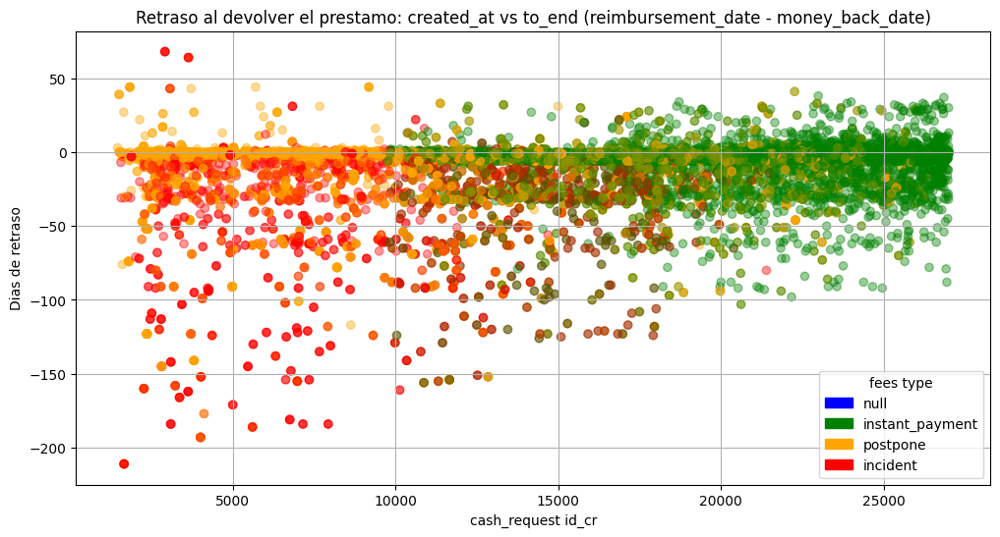

In [9]:
classification_colors = {'null': 'blue', 'instant_payment':'green', 'postpone':'orange', 'incident':'red'}
#df['created_at_w'] = df['created_at']# .dt.to_period('W').astype(str)
df= df.dropna(subset=['to_end'])
df= df.dropna(subset=['type'])
x_values = df['id_cr']
y_values = df['to_end'].dt.days # .astype('int')
c_values= list(df['type'].map(classification_colors))
fig, ax= plt.subplots(figsize=(12,6))
plt.scatter(x= x_values, y= y_values, c=c_values, alpha = .4)
plt.title('Retraso al devolver el prestamo: created_at vs to_end (reimbursement_date - money_back_date)')
plt.xlabel('cash_request id_cr')
plt.ylabel('Dias de retraso')
legend_patches = [mpatches.Patch(color=color, label=type) for type, color in classification_colors.items()]
plt.legend(handles=legend_patches, loc='best', title ='fees type') #upper right')
plt.grid()
plt.show()

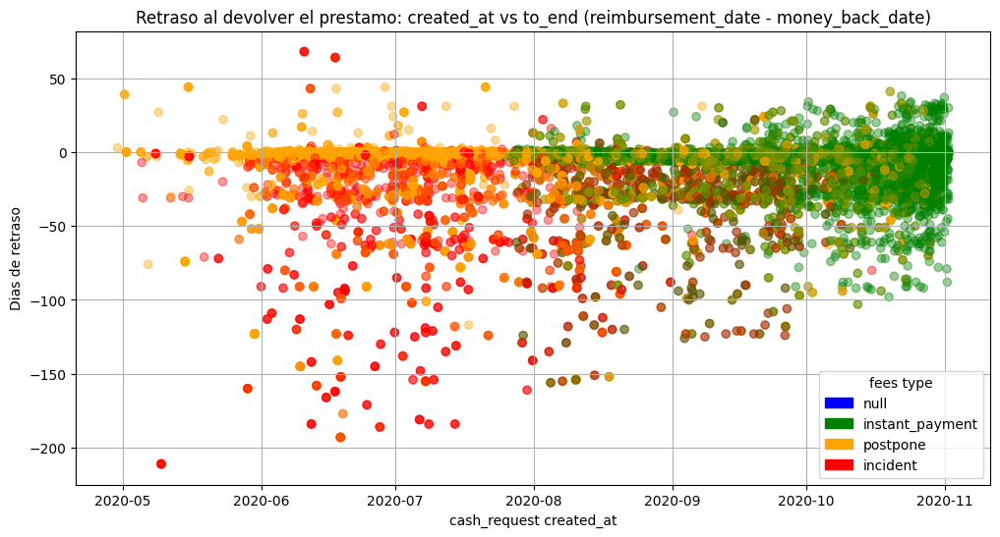

In [ ]:
classification_colors = {'null': 'blue', 'instant_payment':'green', 'postpone':'orange', 'incident':'red'}
#df['created_at_w'] = df['created_at']# .dt.to_period('W').astype(str)
df= df.dropna(subset=['to_end'])
df= df.dropna(subset=['type'])
x_values = df['created_at'] #'id_cr']
y_values = df['to_end'].dt.days # .astype('int')
c_values= list(df['type'].map(classification_colors))
fig, ax= plt.subplots(figsize=(12,6))
plt.scatter(x= x_values, y= y_values, c=c_values, alpha = .4)
plt.title('Retraso al devolver el prestamo: created_at vs to_end (reimbursement_date - money_back_date)')
plt.xlabel('cash_request created_at')
plt.ylabel('Dias de retraso')
legend_patches = [mpatches.Patch(color=color, label=type) for type, color in classification_colors.items()]
plt.legend(handles=legend_patches, loc='best', title ='fees type') #upper right')
plt.grid()
plt.show()

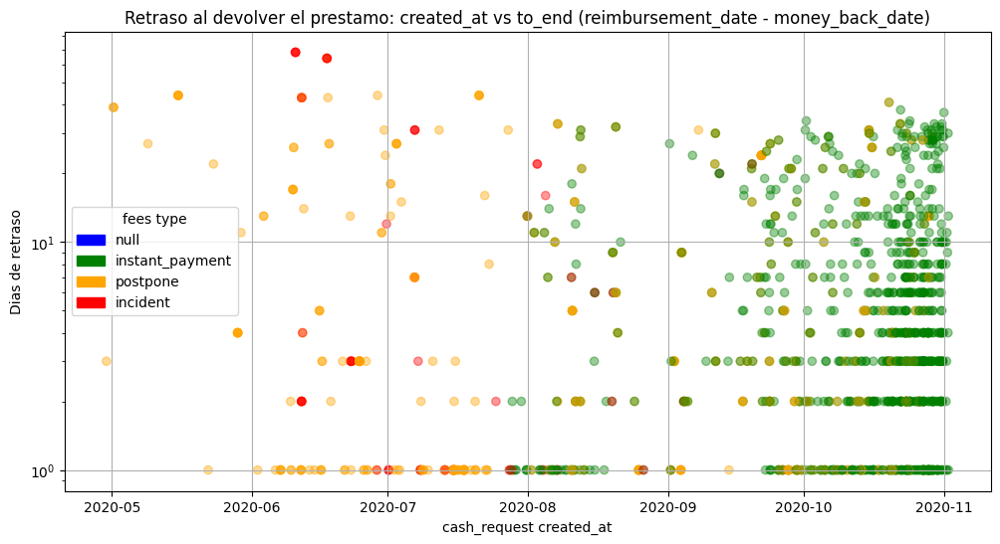

In [ ]:
classification_colors = {'null': 'blue', 'instant_payment':'green', 'postpone':'orange', 'incident':'red'}
#df['created_at_w'] = df['created_at']# .dt.to_period('W').astype(str)
df= df.dropna(subset=['to_end'])
df= df.dropna(subset=['type'])
x_values = df['created_at'] #'id_cr']
y_values = df['to_end'].dt.days # .astype('int')
c_values= list(df['type'].map(classification_colors))
fig, ax= plt.subplots(figsize=(12,6))
plt.scatter(x= x_values, y= y_values, c=c_values, alpha = .4)
plt.title('Retraso al devolver el prestamo: created_at vs to_end (reimbursement_date - money_back_date)')
plt.xlabel('cash_request created_at')
plt.ylabel('Dias de retraso')
legend_patches = [mpatches.Patch(color=color, label=type) for type, color in classification_colors.items()]
plt.legend(handles=legend_patches, loc='best', title ='fees type') #upper right')
plt.yscale('log')
plt.grid()
plt.show()

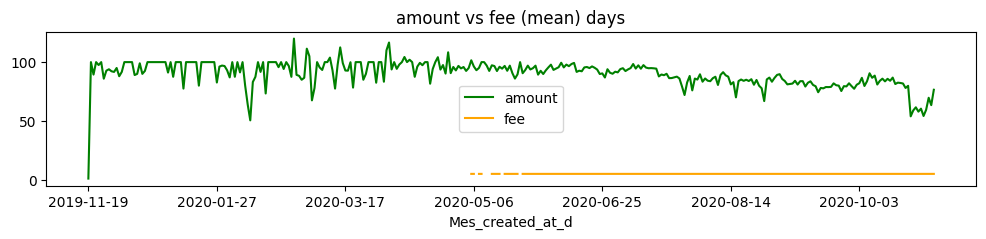

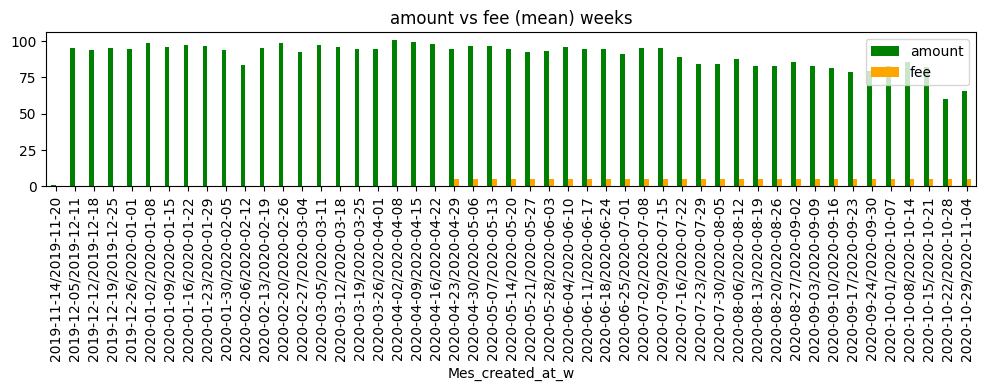

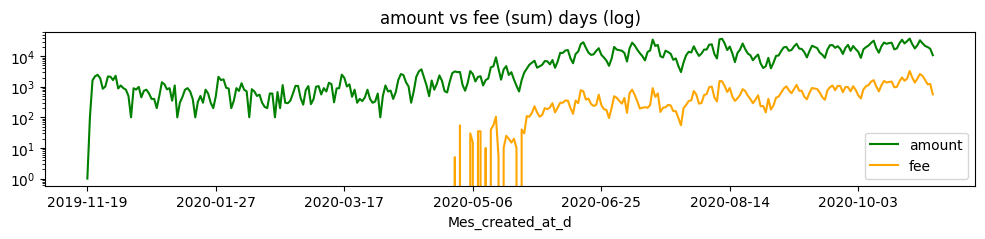

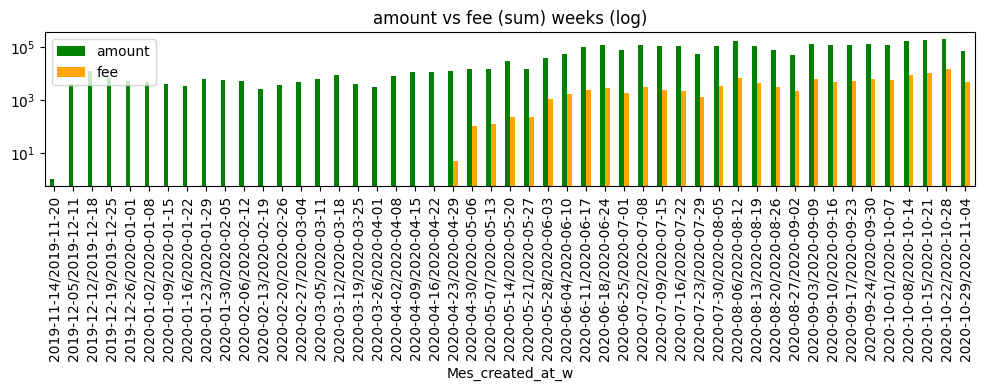

In [ ]:
#df_jo.info()
#display(df_jo)

df_t = df_jo.copy()
df_t['Mes_created_at_d'] = df_t['created_at'].dt.to_period('d').astype(str)
df_t['Mes_created_at_w'] = df_t['created_at'].dt.to_period('W-WED').astype(str)
df_t['Mes_created_at_m'] = df_t['created_at'].dt.to_period('M').astype(str)

fig, ax= plt.subplots(figsize=(12,2))
plt.title('amount vs fee (mean) days')
ratio_bag=df_t.groupby('Mes_created_at_d')[['amount', 'fee']].mean()
ratio_bag.plot(kind='line', color=['green', 'orange'],ax=ax )
plt.show()

fig, ax= plt.subplots(figsize=(12,2))
plt.title('amount vs fee (mean) weeks')
ratio_bag=df_t.groupby('Mes_created_at_w')[['amount', 'fee']].mean()
ratio_bag.plot(kind='bar', color=['green', 'orange'],ax=ax )
plt.show()

# fig, ax= plt.subplots(figsize=(12,2))
# plt.title('amount vs fee (mean) months')
# ratio_bag=df_t.groupby('Mes_created_at_m')[['amount', 'fee']].mean()
# ratio_bag.plot(kind='bar', color=['green', 'orange'],ax=ax )
# plt.show()

fig, ax= plt.subplots(figsize=(12,2))
plt.title('amount vs fee (sum) days (log)')
ratio_bag=df_t.groupby('Mes_created_at_d')[['amount', 'fee']].sum()
ratio_bag.plot(kind='line', color=['green', 'orange'],ax=ax )
plt.yscale('log')
plt.show()

fig, ax= plt.subplots(figsize=(12,2))
plt.title('amount vs fee (sum) weeks (log)')
ratio_bag=df_t.groupby('Mes_created_at_w')[['amount', 'fee']].sum()
ratio_bag.plot(kind='bar', color=['green', 'orange'],ax=ax )
plt.yscale('log')
plt.show()

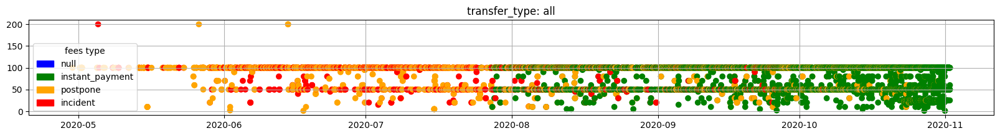

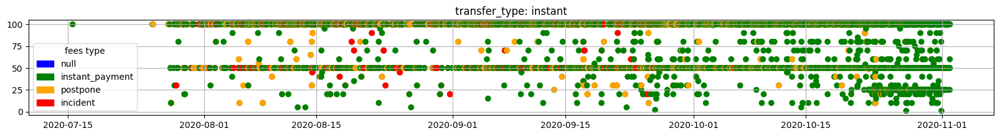

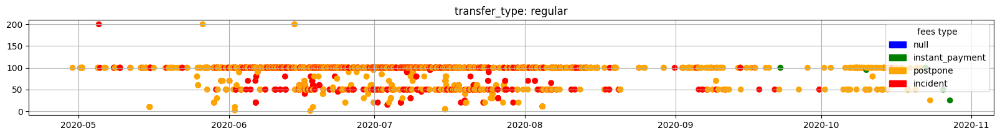

In [ ]:
classification_colors = {'null': 'blue', 'instant_payment':'green', 'postpone':'orange', 'incident':'red'}
df_t = df_jo.copy()
df_t= df_t.dropna(subset=['type'])

#df_t['created_at_w'] = df_t['created_at']# .dt.to_period('W').astype(str)
df_filter = df_t
fig, ax= plt.subplots(figsize=(20,2))
x_values = df_filter['created_at']
y_values = df_filter['amount'] # fee
c_values= list(df_filter['type'].map(classification_colors))
plt.scatter(x= x_values, y= y_values, c=c_values, alpha = 1.)
plt.title('transfer_type: all')
legend_patches = [mpatches.Patch(color=color, label=type) for type, color in classification_colors.items()]
plt.legend(handles=legend_patches, loc='best', title ='fees type') #upper right')
plt.grid()
plt.show()

df_t['created_at_w'] = df_t['created_at']# .dt.to_period('W').astype(str)
df_filter = df_t[df_t['transfer_type']=='instant']
#display(df_filter)
fig, ax= plt.subplots(figsize=(20,2))
x_values = df_filter['created_at_w']
y_values = df_filter['amount'] # fee
c_values= list(df_filter['type'].map(classification_colors))
plt.scatter(x= x_values, y= y_values, c=c_values, alpha = 1.)
plt.title('transfer_type: instant')
legend_patches = [mpatches.Patch(color=color, label=type) for type, color in classification_colors.items()]
plt.legend(handles=legend_patches, loc='best', title ='fees type') #upper right')
plt.grid()
plt.show()

df_t['created_at_w'] = df_t['created_at']# .dt.to_period('W').astype(str)
df_filter = df_t[df_t['transfer_type']=='regular']
#display(df_filter)
fig, ax= plt.subplots(figsize=(20,2))
x_values = df_filter['created_at_w']
y_values = df_filter['amount'] # fee
c_values= list(df_filter['type'].map(classification_colors))
plt.scatter(x= x_values, y= y_values, c=c_values, alpha = 1.)
plt.title('transfer_type: regular')
legend_patches = [mpatches.Patch(color=color, label=type) for type, color in classification_colors.items()]
plt.legend(handles=legend_patches, loc='best', title ='fees type') #upper right')
plt.grid()
plt.show()

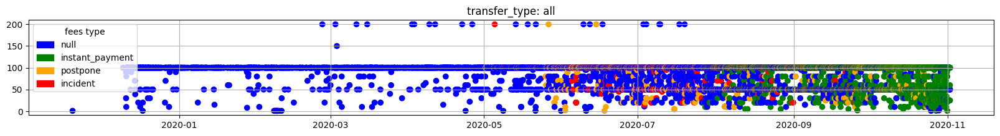

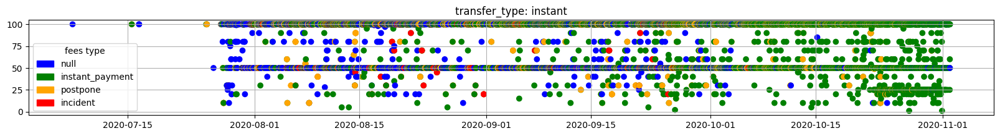

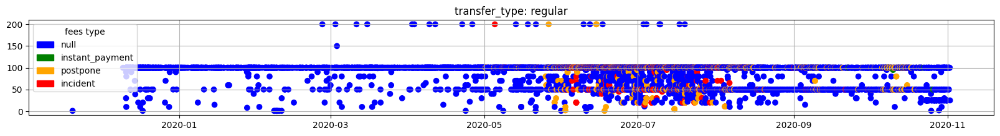

In [ ]:
df_t = df_jo.copy()
#grouped = df_t.groupby(['type'])
df_t['type'] = df_t['type'].fillna('null')
#df_t= df_t.dropna(subset=['type'])

df_t['created_at_w'] = df_t['created_at']# .dt.to_period('W').astype(str)
df_filter = df_t
fig, ax= plt.subplots(figsize=(20,2))
x_values = df_filter['created_at_w']
y_values = df_filter['amount'] # fee
c_values= list(df_filter['type'].map(classification_colors))
plt.scatter(x= x_values, y= y_values, c=c_values, alpha = 1.)
plt.title('transfer_type: all')
legend_patches = [mpatches.Patch(color=color, label=type) for type, color in classification_colors.items()]
plt.legend(handles=legend_patches, loc='best', title ='fees type') #upper right')
plt.grid()
plt.show()

df_t['created_at_w'] = df_t['created_at']# .dt.to_period('W').astype(str)
df_filter = df_t[df_t['transfer_type']=='instant']
#display(df_filter)
fig, ax= plt.subplots(figsize=(20,2))
x_values = df_filter['created_at_w']
y_values = df_filter['amount'] # fee
c_values= list(df_filter['type'].map(classification_colors))
plt.scatter(x= x_values, y= y_values, c=c_values, alpha = 1.)
plt.title('transfer_type: instant')
legend_patches = [mpatches.Patch(color=color, label=type) for type, color in classification_colors.items()]
plt.legend(handles=legend_patches, loc='best', title ='fees type') #upper right')
plt.grid()
plt.show()

df_t['created_at_w'] = df_t['created_at']# .dt.to_period('W').astype(str)
df_filter = df_t[df_t['transfer_type']=='regular']
#display(df_filter)
fig, ax= plt.subplots(figsize=(20,2))
x_values = df_filter['created_at_w']
y_values = df_filter['amount'] # fee
c_values= list(df_filter['type'].map(classification_colors))
plt.scatter(x= x_values, y= y_values, c=c_values, alpha = 1.)
plt.title('transfer_type: regular')
legend_patches = [mpatches.Patch(color=color, label=type) for type, color in classification_colors.items()]
plt.legend(handles=legend_patches, loc='best', title ='fees type') #upper right')
plt.grid()
plt.show()

In [ ]:
#cash_request=pd.read_csv('../data/extract - cash request - data analyst.csv')
#fees=pd.read_csv('../data/extract - fees - data analyst - .csv')
df_jo = pm.df('df_jo')

fig1 = px.imshow(df_jo.isnull(),
color_continuous_scale=['black', 'red'],
labels=dict(color="NaN"),
title="Mapa de calor para cash_request join fees")
fig1.update_layout(width=700, height=700)
fig1.update_coloraxes(showscale=False)
fig1.show()


In [ ]:
# Visualización de distribuciones de datos
columnas_numericas_cash_request=df_jo.describe().columns.tolist()
for c in columnas_numericas_cash_request:
    fig = px.histogram(df_jo, x=c, title=f'Histograma de {c}')
    fig.update_layout(height=500)
    fig.show()